<a href="https://colab.research.google.com/github/guptaShourya/Mobility-Analytics/blob/main/MobilityAnalytics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
!pip install -q dataprep
import warnings
warnings.filterwarnings('ignore')
from dataprep.eda import *

NumExpr defaulting to 2 threads.


In [2]:
train_path = "/content/drive/MyDrive/Machine Learning/Mobility Analytics/train_Wc8LBpr.csv"
# read data
data = pd.read_csv(train_path)

In [3]:
# val_path = '/content/drive/MyDrive/Machine Learning/Mobility Analytics/test_VsU9xXK.csv'
# val = pd.read_csv(val_path)

In [4]:
data.head(10)

,Trip_ID,Trip_Distance,Type_of_Cab,Customer_Since_Months,Life_Style_Index,Confidence_Life_Style_Index,Destination_Type,Customer_Rating,Cancellation_Last_1Month,Var1,Var2,Var3,Gender,Surge_Pricing_Type
0,T0005689460,6.77,B,1.0,2.42769,A,A,3.90500,0,40.0,46,60,Female,2
1,T0005689461,29.47,B,10.0,2.78245,B,A,3.45000,0,38.0,56,78,Male,2
2,T0005689464,41.58,NaN,10.0,NaN,NaN,E,3.50125,2,NaN,56,77,Male,2
3,T0005689465,61.56,C,10.0,NaN,NaN,A,3.45375,0,NaN,52,74,Male,3
4,T0005689467,54.95,C,10.0,3.03453,B,A,3.40250,4,51.0,49,102,Male,2
5,T0005689469,19.06,E,10.0,NaN,NaN,A,2.59750,1,72.0,63,91,Male,3
6,T0005689470,29.72,E,10.0,2.83958,C,B,2.97500,1,83.0,50,75,Male,2
7,T0005689472,18.44,B,2.0,2.81871,B,A,3.58250,0,103.0,46,63,Male,2
8,T0005689473,106.80,C,3.0,NaN,NaN,A,3.14625,0,NaN,58,92,Male,2
9,T0005689474,107.19,D,5.0,3.04467,B,A,2.44375,1,NaN,58,83,Male,3


In [5]:
# number of rows and columns in dataset
rows = data.shape[0]
columns = data.shape[1]
print("Data has {} rows, {} columns".format(rows, columns))

Data has 131662 rows, 14 columns


In [6]:
data.drop(['Trip_ID'], axis=1, inplace=True)
# t_ids = val['Trip_ID']
# val.drop(['Trip_ID'], axis=1, inplace=True)

# SPLIT DATA

In [7]:
from sklearn.model_selection import train_test_split

# split data into train and validation part
train, val = train_test_split(data, test_size = 0.3, random_state = 5)

# UNIVARIATE ANALYSIS

In [8]:
train.head(10)

,Trip_Distance,Type_of_Cab,Customer_Since_Months,Life_Style_Index,Confidence_Life_Style_Index,Destination_Type,Customer_Rating,Cancellation_Last_1Month,Var1,Var2,Var3,Gender,Surge_Pricing_Type
98490,9.90,A,2.0,2.67373,A,B,3.28625,2,NaN,49,78,Male,1
37055,26.53,B,1.0,2.74663,A,A,2.54500,0,NaN,51,71,Male,2
56407,91.69,NaN,3.0,2.84348,B,A,1.42125,0,102.0,54,73,Male,2
47591,65.06,NaN,2.0,2.80567,C,B,0.01500,0,55.0,55,95,Male,3
79397,63.88,C,2.0,3.05402,A,A,3.12250,2,NaN,52,74,Male,2
74653,36.91,C,1.0,2.54269,B,A,2.28750,0,NaN,48,70,Male,2
8493,58.43,D,3.0,2.72195,B,A,1.65750,1,NaN,49,68,Male,3
76515,17.75,B,0.0,2.54894,B,F,3.48250,3,47.0,48,61,Male,2
74943,75.60,D,10.0,2.85765,B,B,1.88500,1,NaN,47,67,Male,2
32799,61.07,D,6.0,2.67286,B,A,2.15625,0,NaN,50,68,Male,3


## CONVERT CATEGORICALS

In [9]:
# mapping
TOC_replace = {'A':0, 'B':1, 'C':2, 'D':3, 'E':4, 'F':5, 'G':6, 'H':7, 'I':8, 'J':9, 'K':10, 'L':11, 'M':12, 'N':13}

# replace in Type_of_Cab
train['Type_of_Cab'] = train['Type_of_Cab'].replace(TOC_replace)
val['Type_of_Cab'] = val['Type_of_Cab'].replace(TOC_replace)
# replace in Confidence_Life_Style_Index
train['Confidence_Life_Style_Index'] = train['Confidence_Life_Style_Index'].replace(TOC_replace)
val['Confidence_Life_Style_Index'] = val['Confidence_Life_Style_Index'].replace(TOC_replace)
# replace in Destination_Type
train['Destination_Type'] = train['Destination_Type'].replace(TOC_replace)
val['Destination_Type'] = val['Destination_Type'].replace(TOC_replace)

In [10]:
# replace in Gender
gender_replace = {'Male':0, 'Female':1}

train['Gender'] = train['Gender'].replace(gender_replace)
val['Gender'] = val['Gender'].replace(gender_replace)

## HANDLE NULLS

Dropping Var1 becuase of more than 50% nulls

In [11]:
train.drop(['Var1'], axis=1, inplace=True)
val.drop(['Var1'], axis=1, inplace=True)

In [12]:
# columns with null and method to use to fill nulls
nulls_cols = {'Type_of_Cab':'mode', 'Customer_Since_Months':'median', 'Life_Style_Index':'median', 'Confidence_Life_Style_Index':'mode'}

#### NULLS V1: MEDIAN/MODE IMPUTATION
SINCE IN ALL THE OTHER COLUMNS EXPCET 'Customer_Since_Months' THERE ARE MORE THAN 10% NULLS, IT WOULD HAVE BEEN MEANINGFUL TO IMPUTE NULLS VIA ML STRATEGIES (DATAWIG IN PARTICULAR). BUT DUE TO ISSUES WITH DATAWIG IN COLAB WE'RE LEFT TO MODE/MEDIAN IMPUTATION.

In [13]:
def impute_nulls(train, test, column, method):
  '''
  imputes nulls for a given 'column' using mentioned 'method' in both 'train' and 'test'

  Args:
    train, test (Pandas Dataframe) : train & test datasets
    columns (string) : name of column to impute nulls in
    method (string) : method to use to fill nulls, either "mode" or "median"

  Returns:
    tuple : train, test datasets with imputed nulls
  '''
  # init value to be filled
  fill_val = -1
  # mode method
  if(method == 'mode'):
    fill_val = train[column].mode().values[0]
  # median method
  elif(method == 'median'):
    fill_val = train[column].median()
  # incorrect method
  else:
    print("ERROR: check method value, can either be median or mode.")
    return
  # replace nulls
  train.fillna(value=fill_val, inplace=True)
  test.fillna(value=fill_val, inplace=True)
  return (train, test)

In [14]:
# fill nulls
for col in nulls_cols:
  train, val = impute_nulls(train, val, col, nulls_cols[col])

Trip_Distance


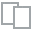
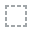
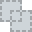
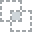
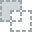
...
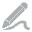
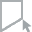
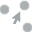
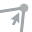
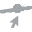

In [15]:
plot(train, col1='Trip_Distance')

Type_of_Cab


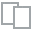
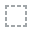
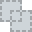
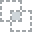
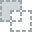
...
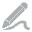
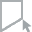
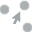
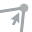
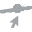

In [16]:
plot(train, col1='Type_of_Cab')

Customer_Since_Months

Zeros indicate a new customer


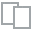
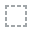
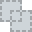
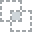
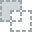
...
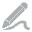
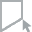
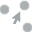
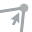
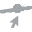

In [17]:
plot(train, col1='Customer_Since_Months')

Life_Style_Index

keeping outliers


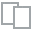
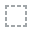
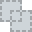
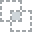
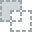
...
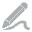
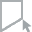
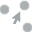
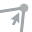
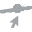

In [18]:
plot(train, col1='Life_Style_Index')

Confidence_Life_Style_Index

no idea what it is


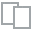
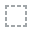
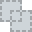
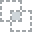
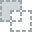
...
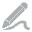
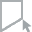
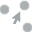
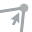
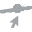

In [19]:
plot(train, col1='Confidence_Life_Style_Index')

Destination_Type

need further bivariate analysis


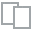
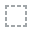
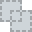
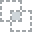
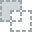
...
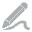
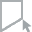
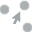
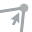
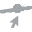

In [20]:
plot(train, col1='Destination_Type')

Customer_Rating

can be used with customer_since_months


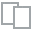
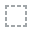
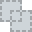
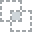
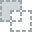
...
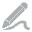
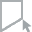
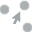
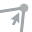
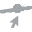

In [21]:
plot(train, col1='Customer_Rating')

Cancellation_Last_1Month

can be used with customer_since_monhts, and customer_rating. 
lower rating and more cancellations


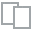
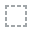
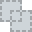
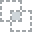
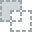
...
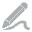
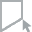
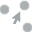
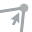
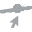

In [22]:
plot(train, col1='Cancellation_Last_1Month')

Var2


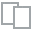
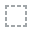
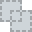
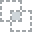
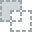
...
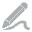
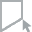
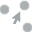
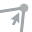
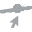

In [23]:
plot(train, col1='Var2')

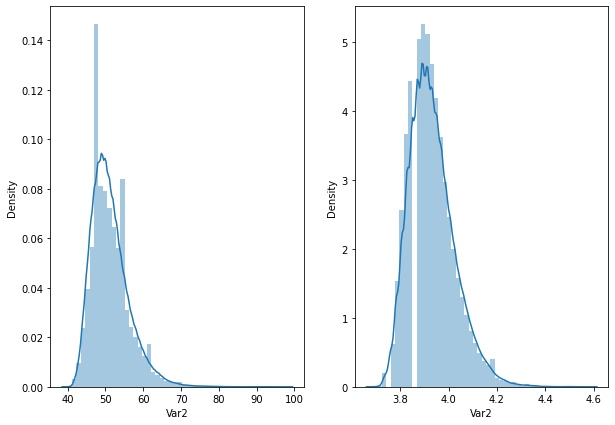

In [24]:
f, ax = plt.subplots(nrows=1, ncols=2, figsize=(10, 7))
sns.distplot(train['Var2'], ax=ax[0])
sns.distplot(np.log(train['Var2']), ax=ax[1])

Var3


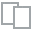
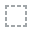
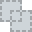
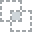
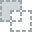
...
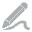
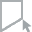
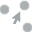
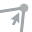
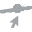

In [25]:
plot(train, col1='Var3')

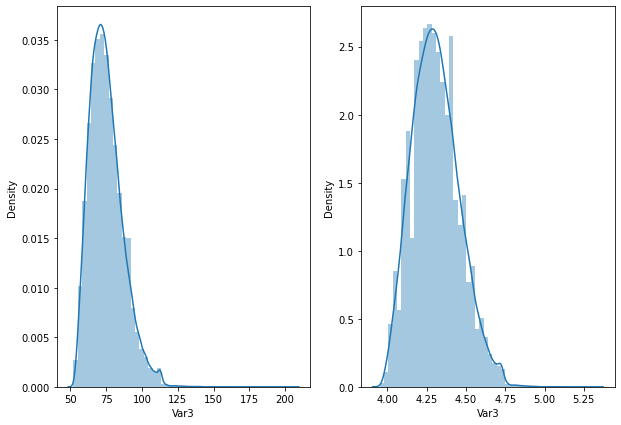

In [26]:
f, ax = plt.subplots(nrows=1, ncols=2, figsize=(10, 7))
sns.distplot(train['Var3'], ax=ax[0])
sns.distplot(np.log(train['Var3']), ax=ax[1])

Gender


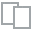
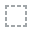
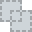
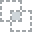
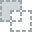
...
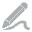
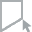
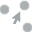
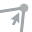
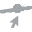

In [27]:
plot(train, col1='Gender')

Surge_Pricing_Type


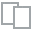
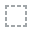
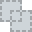
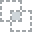
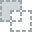
...
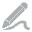
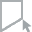
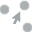
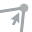
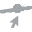

In [28]:
plot(train, 'Surge_Pricing_Type')

# BIVARIATE ANALYSIS

In [29]:
train_sample = train.sample(frac=0.25)


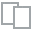
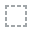
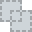
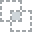
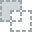
...
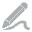
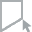
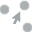
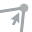
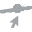

In [30]:
plot_correlation(train_sample)

'Gender' doesn't add any info on it's own

In [31]:
def plot_bivariate(x, y, data):
    '''
    plots a hue bar graph with y scale values normalised for given params
    Args:
        x (string) : column to group by
        y (string) : column to apply grouping on
        data (DataFrame) : dataset
    Returns:
        NA
    '''
    f, ax = plt.subplots(figsize=(10, 7))

    df1 = data.groupby(x)[y].value_counts(normalize=True)
    df1 = df1.mul(100)
    df1 = df1.rename('percent').reset_index()

    sns.barplot(x=x,y='percent',hue=y,data=df1, ax=ax)
    plt.show()

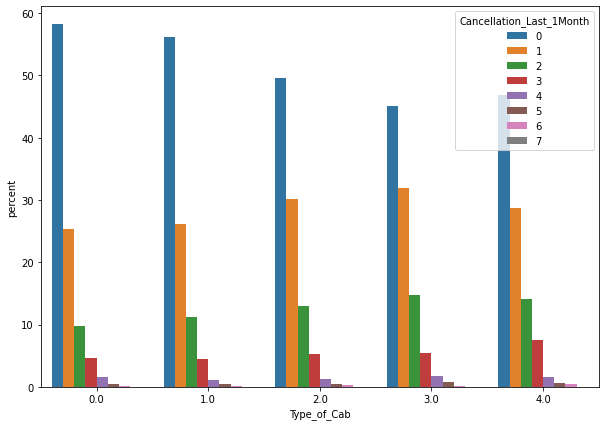

In [32]:
plot_bivariate('Type_of_Cab', 'Cancellation_Last_1Month', train_sample)

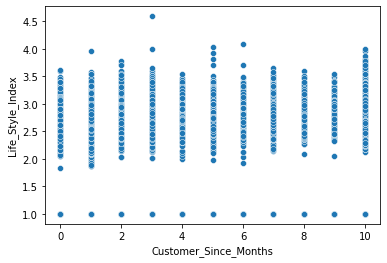

In [33]:
sns.scatterplot(y='Life_Style_Index', x = 'Customer_Since_Months', data = train_sample )

combine customer_since_months with life_style_index

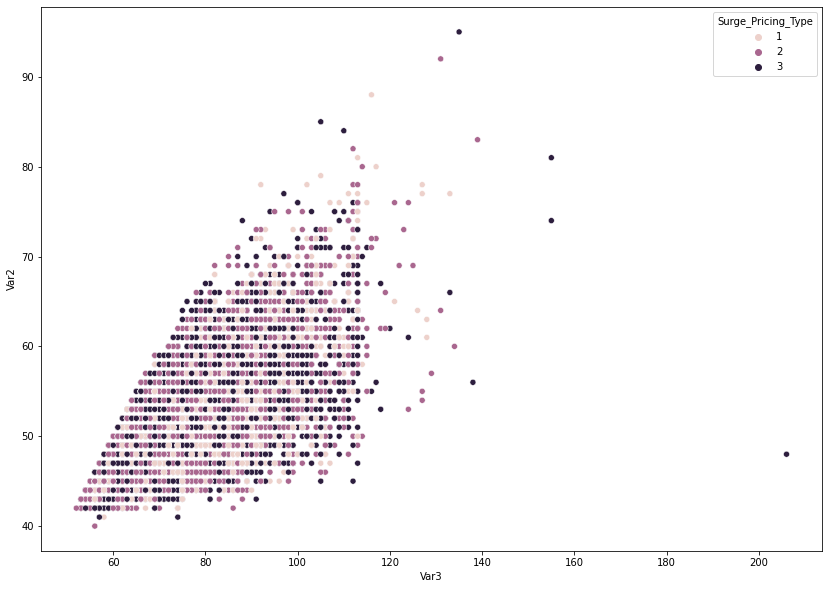

In [34]:
f, ax = plt.subplots(figsize=(14, 10))
sns.scatterplot(y='Var2', x = 'Var3', hue='Surge_Pricing_Type', data = train_sample, ax=ax)
plt.show()

Can try to combine var2 and var3

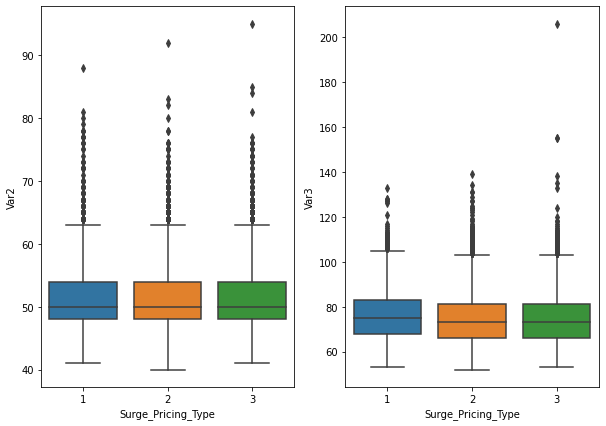

In [35]:
f, ax = plt.subplots(nrows=1, ncols=2, figsize=(10, 7))
sns.boxplot(x='Surge_Pricing_Type', y='Var2', data=train_sample, ax=ax[0])
sns.boxplot(x='Surge_Pricing_Type', y='Var3', data=train_sample, ax=ax[1])

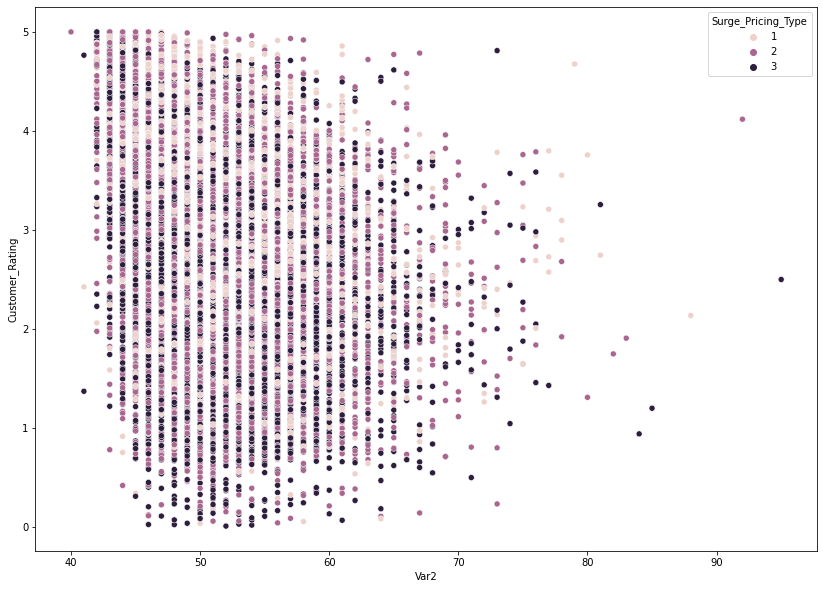

In [36]:
f, ax = plt.subplots(figsize=(14, 10))
sns.scatterplot(x='Var2', y = 'Customer_Rating', hue='Surge_Pricing_Type', data = train_sample, ax=ax)
plt.show()

Can combine var2 with Customer_Rating

# SCALE VALUES

In [39]:
ytrain = train['Surge_Pricing_Type']
xtrain = train.drop(['Surge_Pricing_Type'], axis=1)

yval = val['Surge_Pricing_Type']
xval = val.drop(['Surge_Pricing_Type'], axis=1)

In [40]:
from sklearn.preprocessing import StandardScaler

# intialise StandardScaler
scaler = StandardScaler()

# Scale training data
xtrain = scaler.fit_transform(xtrain)

# Scale validation data
xval = scaler.transform(xval)

# DIMENSIONALITY REDUCTION

In [41]:
from sklearn.decomposition import PCA

def reduceDim(X_train, threshold_PCA):
    ''' 
    Calculates number of Principal Components to retain 
    atleast "threshold" variance
    
    Args:
        X_train (DataFrame) : The training dataset in form of Pandas DataFrame
        threshold_PCA (float) : Minimum value of variance to retain
    
    Returns:
        PCA object : The PCA instance to transform validation and test data
        DataFrame : The transformed training dataset
    '''
#     intialise PCA
    pca = PCA(n_components = threshold_PCA)
#     fit and transform training data
    X_train_PCA = pca.fit_transform(X_train)
    
#     print info
    print("Number of columns retained : {} \nNumber of columns in original dataset : {}"
          .format(X_train_PCA.shape[1], X_train.shape[1]))
    
    return (pca, X_train_PCA)

In [42]:
# pca, xtrain = reduceDim(xtrain, 0.99)

# MACHINE LEARNING

In [43]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score


def getScore(clf, X, y, method='acc'):
    ''' 
    Calculates roc_auc_score for the given data using "clf"
    
    Args:
        clf : The instance for classification algorithm
        X (Numpy Array) : The dependent variables
        y (Numpy Array) : The independent variables
        method (String) : method of score calculation
    
    Returns:
        float : The score calculated
    '''
    if('f1'):
      return f1_score(y, clf.predict(X), average='macro')
    return accuracy_score(y, clf.predict(X))

In [44]:
def printReport(clf, X_train, y_train, X_val, y_val):
    ''' 
    reports roc_auc_score for the training and validation data using "clf"
    
    Args:
        clf : The instance for classification algorithm
        X_train (Numpy Array) : The dependent variables for training
        y_train (Numpy Array) : The independent variables for training
        X_val (Numpy Array) : The dependent variables for validation
        y_val (Numpy Array) : The independent variables for validation
    
    Returns:
        (float, float) : Training & Validation score
    '''
#     find scores
    train_score = getScore(clf, X_train, y_train)
    val_score = getScore(clf, X_val, y_val)
    
    print("Training Score : {}\nValidation Score: {}".format(train_score, val_score))
    
    return (train_score, val_score)

In [45]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV #import GridSearchCV

params = {'C' : [0.0001, 0.0003, 0.0005, 0.001, 0.003, 0.005, 0.01, 0.03, 0.05, 0.1, 0.3, 0.5]} # values of C parameter in LR to try for

clf_lr = GridSearchCV(LogisticRegression(), params) # Logistic Regression

clf_lr.fit(xtrain, ytrain) # train LR model_selection

printReport(clf_lr, xtrain, ytrain, xval, yval)

Training Score : 0.6308703686476941
Validation Score: 0.6298610872868883


(0.6308703686476941, 0.6298610872868883)

In [46]:
from lightgbm import LGBMClassifier

# intialise LGBM algorithm
clf_lgbm = LGBMClassifier()

# fit on training data
clf_lgbm.fit(xtrain, ytrain)

printReport(clf_lgbm, xtrain, ytrain, xval, yval)

LGBMClassifier()

In [47]:
from xgboost import XGBClassifier

# intialise XGB algorithm
clf_xgb = XGBClassifier(tree_method='gpu_hist', eta = 0.5)

# fit on training data
clf_xgb.fit(xtrain, ytrain)

xgb_scores = printReport(clf_xgb, xtrain, ytrain, xval, yval)

Training Score : 0.6679464672513867
Validation Score: 0.6662594685995337


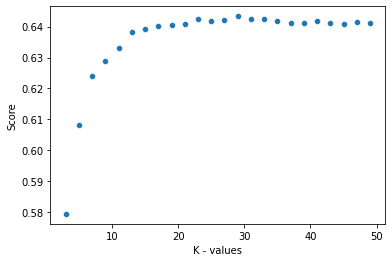

In [48]:
from sklearn.neighbors import KNeighborsClassifier #import KNN model

knn_au_y = [] # to store k values
knn_au_x = [] # to store score corresponding to k values

# loop over every odd integer from 3 to 21 and use it as n_neighbors in Knn
for k in range(3, 51, 2): 
  clf = KNeighborsClassifier(n_neighbors=k, metric='euclidean') #set up KNN model
  clf.fit(xtrain, ytrain) #fit model
  knn_au_y.append(getScore(clf, xval, yval, 'f1')) #append score
  knn_au_x.append(k) #append K value

sns.scatterplot(x = knn_au_x, y = knn_au_y) #scatterplot

plt.ylabel("Score") # label y-axis 'score'
plt.xlabel("K - values") # label x-axis 'Algorithms'

plt.show() # display plot


In [49]:
clf_knn = KNeighborsClassifier(n_neighbors=21, metric='euclidean') # using K = 15 
clf_knn.fit(xtrain, ytrain) #fit model

printReport(clf_knn, xtrain, ytrain, xval, yval)

Training Score : 0.6704632996396503
Validation Score: 0.6406851906714659


(0.6704632996396503, 0.6406851906714659)

In [ ]:
# sub = pd.DataFrame(t_ids, columns=['Trip_ID'])
# sub['Surge_Pricing_Type'] = clf_lgbm.predict(xval)

In [ ]:
# sub.to_csv()

In [ ]:
# sub.to_csv('/content/drive/MyDrive/Machine Learning/Mobility Analytics/sub1.csv', index=False)